In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.io
import scanpy.external as scex
import sklearn.metrics
import seaborn as sns
from matplotlib import pyplot as plt

import sys
sys.path.insert(1, '../mhCompTiss/')

import scanpyHelpers as scH

In [2]:
#adata=sc.read(results_file_post)
#adata.uns['log1p'] = {"base":None}

Set up out properties

In [95]:
sc.settings.verbosity = 0            # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, dpi_save=300, facecolor='white', format="svg", transparent=True)

scanpy==1.9.3 anndata==0.10.7 umap==0.5.5 numpy==1.26.4 scipy==1.13.0 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 python-igraph==0.10.4 pynndescent==0.5.12


In [4]:
%matplotlib inline

Set scanpy out-files

In [5]:
writeDir = "write/"

fileName = "pdacPdxMrtxGA60"

resultsFile = writeDir + fileName + '.h5ad'       # final output
resultsFileTotal = writeDir + fileName + 'wImm.h5ad'       # final output
resultsFileQC = writeDir + fileName + '_QC.h5ad'  # post QC (pre-analysis) 

Set figure parameters

In [6]:
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=150, fontsize=10, format='png')
sc.settings.figdir = "figures/" + fileName + "/"
figName = fileName

In [7]:
adata = sc.read(resultsFileQC)
adata

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 14508 × 23942
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'treatment'

In [10]:
#adata.obs.GMM.cat.categories

In [11]:
#hashNames = ['MRTX1_B0251', 'MRTX2_B0252', 'MRTX3_B0253', 
#            'Vehicle1_B0254', 'Vehicle2_B0255', 'Vehicle3_B0256']
#singlets = [x in hashNames for x in adata.obs["GMM"] ]
#adata = adata[singlets,]

In [12]:
#sc.pp.normalize_total(adata,target_sum=1e4)

In [13]:
#sc.pp.log1p(adata)

In [15]:
cell_cycle_genes = [x.strip() for x in open('../pdx/data/regev_lab_cell_cycle_genes_Human.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [16]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    555 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    601 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


computing PCA
    with n_comps=50
    finished (0:00:00)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


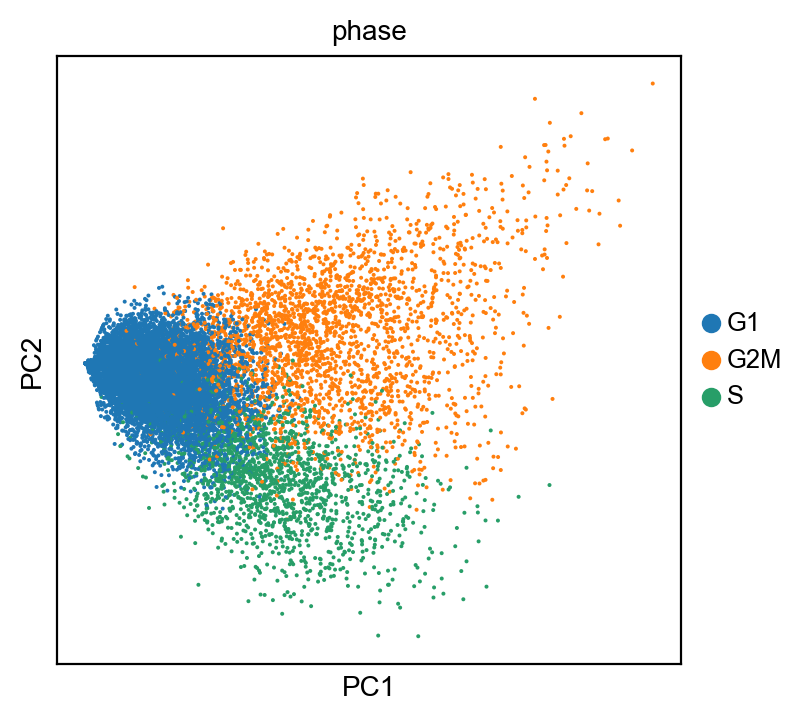

In [18]:
adata_cc_genes = adata[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color=['phase'])#,"Classification"])

In [19]:
sc.pp.highly_variable_genes(adata, batch_key="treatment")#, flavor = "seurat", n_top_genes=2000)

extracting highly variable genes


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


    finished (0:00:07)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:495: FutureWarning: The provided callable <function nanmean at 0x7ff5602184c0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df = df.groupby('gene').agg(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:495: FutureWarning: The provided callable <function nanmean

extracting highly variable genes


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


    finished (0:00:07)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:495: FutureWarning: The provided callable <function nanmean at 0x7ff5602184c0> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  df = df.groupby('gene').agg(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:495: FutureWarning: The provided callable <function nanmean

2679
1464


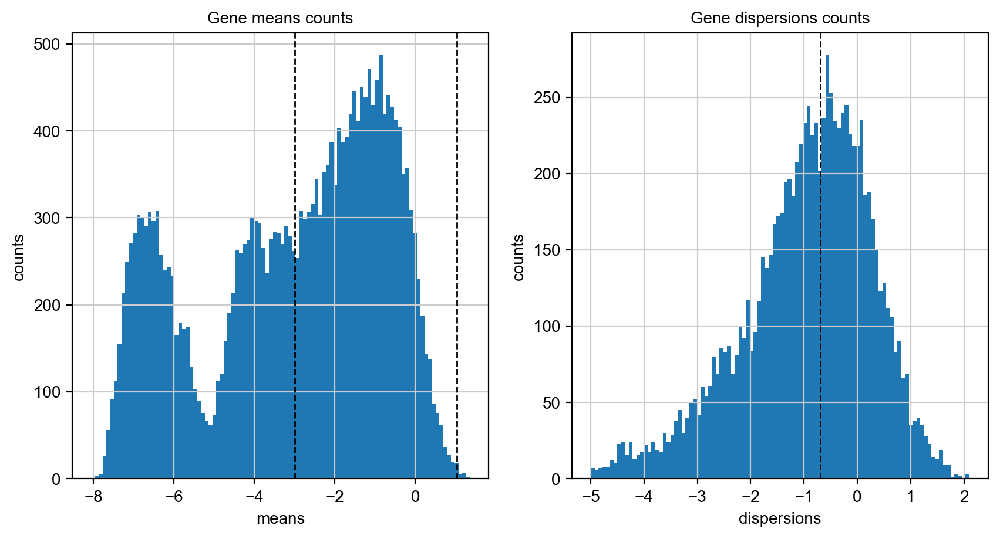

In [22]:
minMean = 0.05
maxMean = 2.8
minDisp = 0.5

fig, axs = plt.subplots(1, 2, figsize=(10, 5))

means = adata.var[["means"]][adata.var[["means"]] > np.exp(-14)]#adata.var[["means"]],
axs[0].hist(np.log(means), bins=100)#, log=True),
axs[0].axvline(np.log(minMean), color='k', linestyle='dashed', linewidth=1)
axs[0].axvline(np.log(maxMean), color='k', linestyle='dashed', linewidth=1)
axs[0].set_title('Gene means counts')
axs[0].set_xlabel('means')
axs[0].set_ylabel('counts')

dispNorm = adata.var[["dispersions_norm"]][adata.var[["dispersions_norm"]] > np.exp(-5)]#adata.var[["means"]],
axs[1].hist(np.log(dispNorm), bins=100)#, log=True),
axs[1].axvline(np.log(minDisp), color='k', linestyle='dashed', linewidth=1)
axs[1].set_title('Gene dispersions counts')
axs[1].set_xlabel('dispersions')
axs[1].set_ylabel('counts')

sc.pp.highly_variable_genes(adata, min_disp=minDisp, min_mean=minMean, max_mean=maxMean, batch_key="treatment")
print(sum(adata.var.highly_variable))
print(sum(adata.var.highly_variable_intersection))

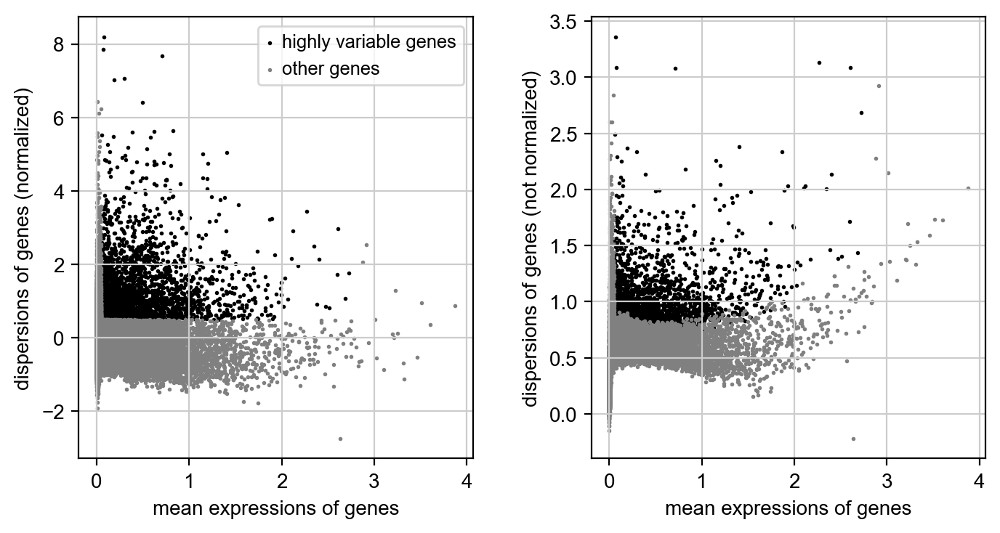

In [23]:
sc.pl.highly_variable_genes(adata)

In [24]:
#for inGene in adata.var[-8:].index.tolist():
#    adata.var.loc[inGene,"highly_variable"] = False

In [25]:
adata.var['mt'] = adata.var_names.str.startswith('MT-') 

In [26]:
adata.raw = adata

In [27]:
#adata = adata[:, adata.var.highly_variable]
adata = adata[:, np.logical_and(adata.var.highly_variable_intersection, np.logical_not(adata.var.mt))]

In [28]:
#sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

In [29]:
#sc.pp.scale(adata, max_value=10)

In [30]:
sc.tl.pca(adata, n_comps = 100, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:03)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca


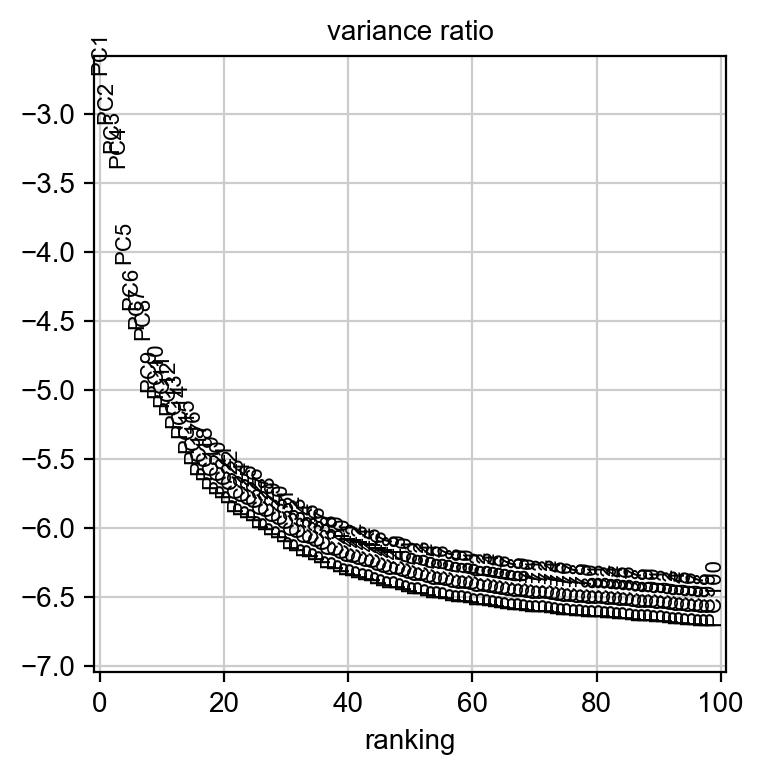

In [31]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100, log=True)

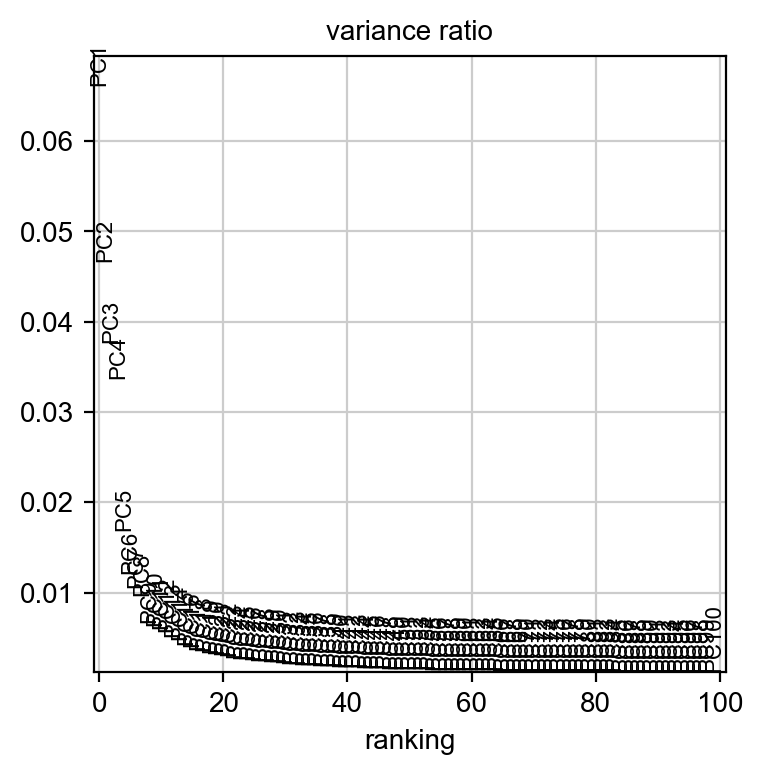

In [32]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100)

In [130]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=40)

In [131]:
sc.tl.umap(adata)

In [132]:
sc.tl.leiden(adata, resolution=0.7)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

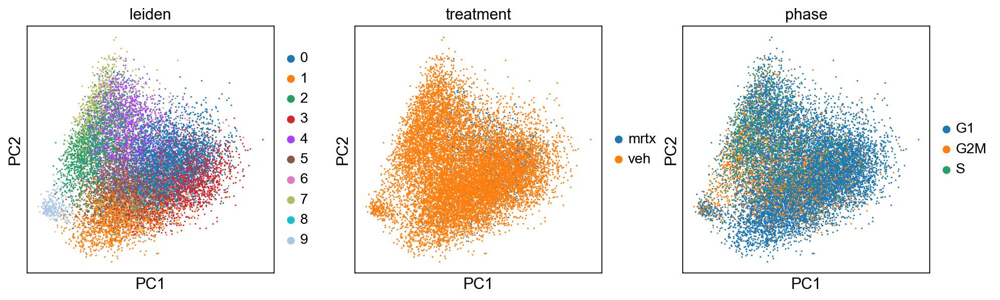

In [133]:
sc.pl.pca(adata, color=["leiden","treatment","phase"],ncols=4)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

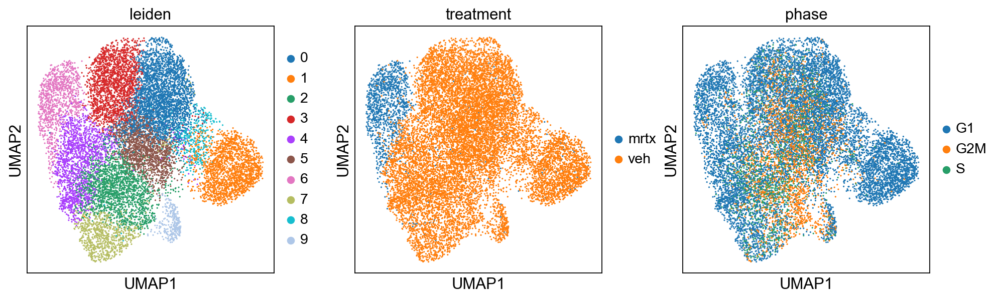

In [134]:
sc.pl.umap(adata, color=["leiden","treatment","phase"],ncols=4)

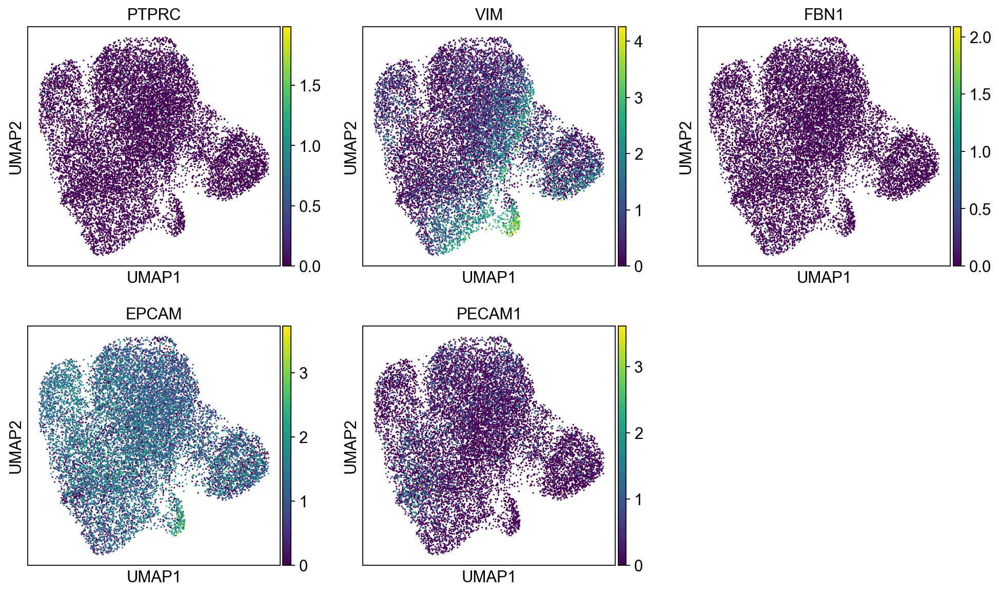

In [135]:
sc.pl.umap(adata, color=["PTPRC","VIM","FBN1","EPCAM","PECAM1"],ncols=3)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

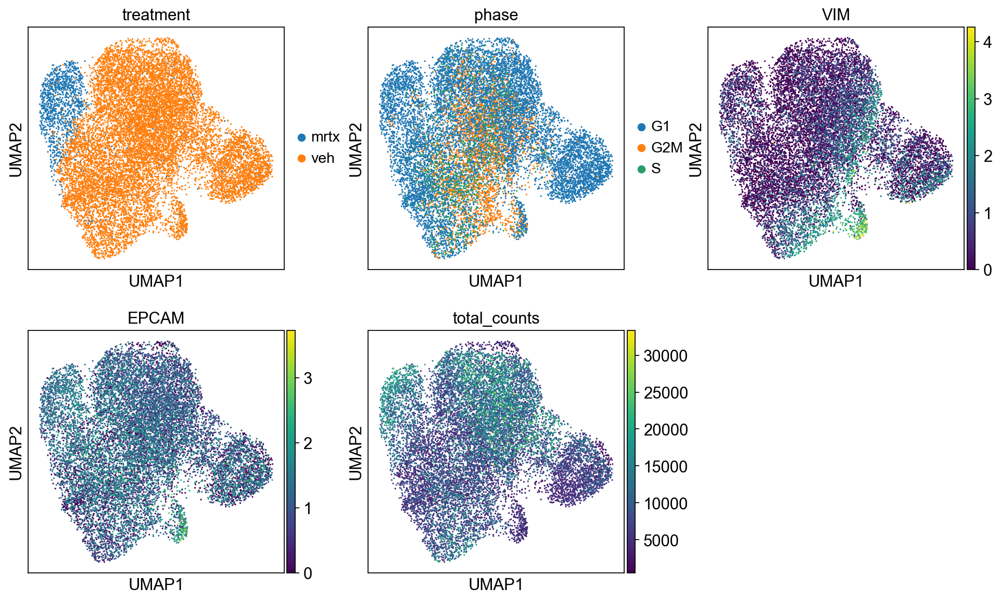

In [136]:
sc.pl.umap(adata, color=["treatment","phase","VIM","EPCAM","total_counts"],ncols=3)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

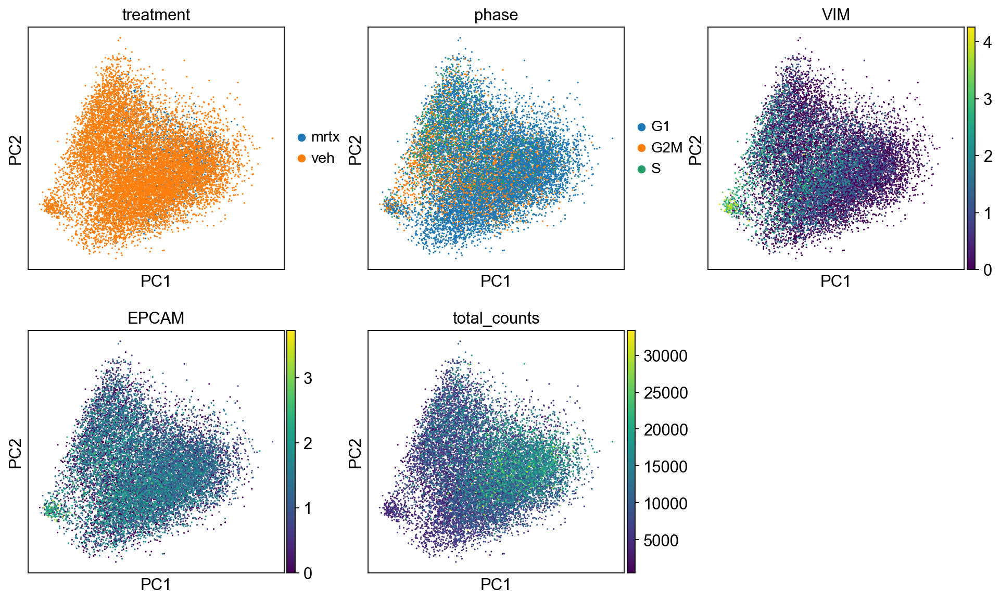

In [137]:
sc.pl.pca(adata, color=["treatment","phase","VIM","EPCAM","total_counts"],ncols=3)

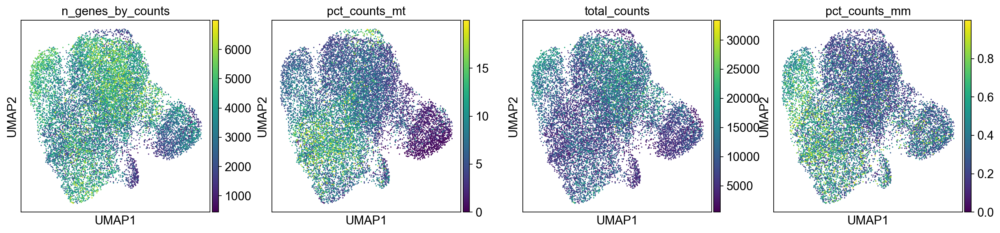

In [138]:
sc.pl.umap(adata, color=["n_genes_by_counts","pct_counts_mt","total_counts","pct_counts_mm"])

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


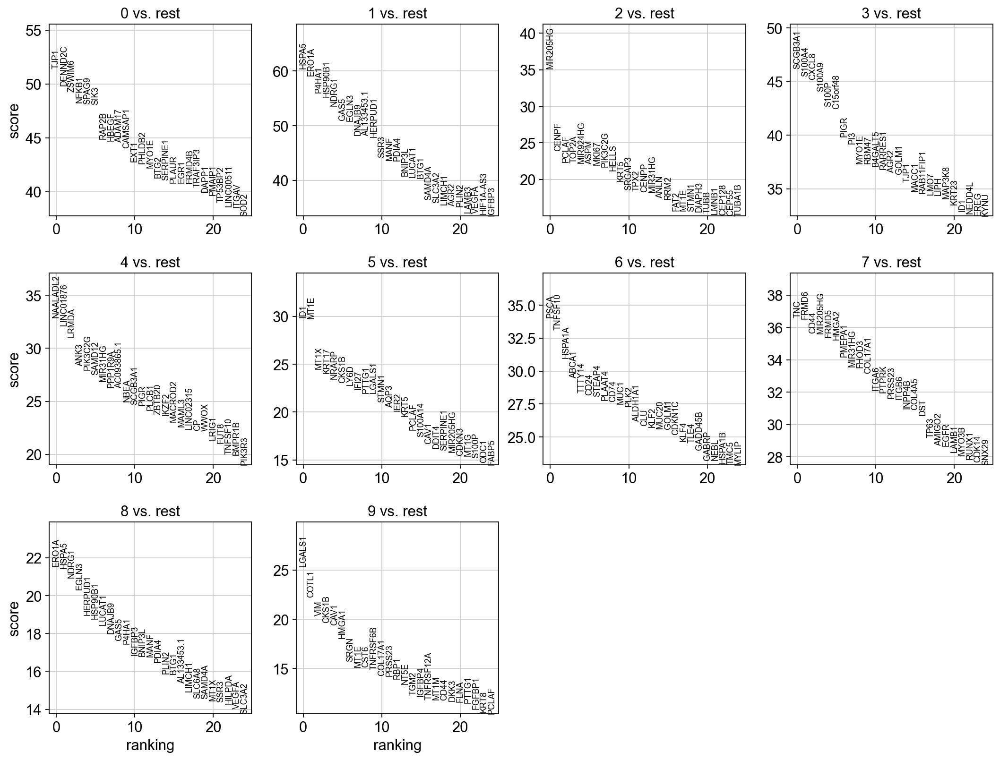

In [139]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon', use_raw=False)
#sc.tl.filter_rank_genes_groups(adata, groupby="leiden", use_raw=False,
#                                   key_added='rank_genes_groups_filtered', 
#                                   min_in_group_fraction=0.25, min_fold_change=1, max_out_group_fraction=0.5, compare_abs=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [140]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(15)

,0,1,2,3,4,5,6,7,8,9
0,TJP1,HSPA5,MIR205HG,SCGB3A1,NAALADL2,ID1,PSCA,TNC,ERO1A,LGALS1
1,DENND2C,ERO1A,CENPF,S100A4,LINC01876,MT1E,TNFSF10,FRMD6,HSPA5,COTL1
2,ZSWIM6,P4HA1,PCLAF,CXCL8,LRMDA,MT1X,HSPA1A,CD44,NDRG1,VIM
3,NFKB1,HSP90B1,TOP2A,S100A9,ANK3,KRT17,ABCA1,MIR205HG,EGLN3,CKS1B
4,SPAG9,NDRG1,MIR924HG,S100P,PIK3C2G,NRARP,TTTY14,FRMD5,HERPUD1,CAV1
5,SIK3,GAS5,ASPM,C15orf48,SAMD12,CKS1B,CD24,HMGA2,HSP90B1,HMGA1
6,RAP2B,EGLN3,MKI67,PIGR,MIR31HG,LY6D,STEAP4,PMEPA1,LUCAT1,SRGN
7,HBEGF,DNAJB9,PIK3C2G,PI3,PPP1R9A,IFI27,PLAAT4,MIR31HG,DNAJB9,MT1E
8,ADAM17,AL133453.1,HELLS,MYO1E,AC093865.1,PTTG1,CD74,FHOD3,GAS5,CST6
9,CAMSAP1,HERPUD1,KRT5,RBM47,NBEA,LGALS1,MUC1,COL17A1,P4HA1,TNFRSF6B


In [141]:
#adata.obs["tumor"] = ["oth" if l in ["1",'3'] else "tum" for l in adata.obs.leiden]

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

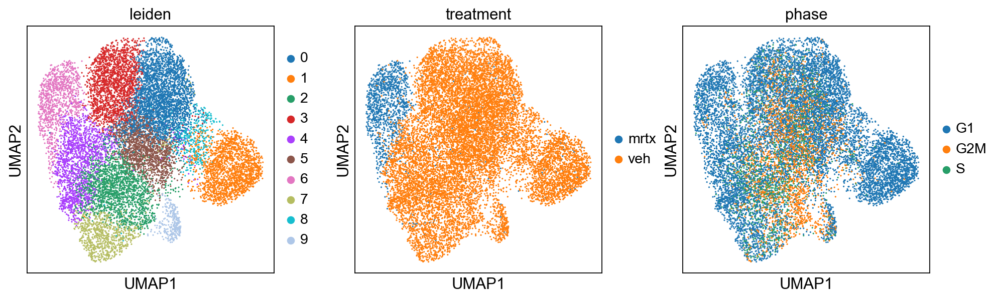

In [142]:
sc.pl.umap(adata, color=["leiden","treatment","phase"],ncols=3)

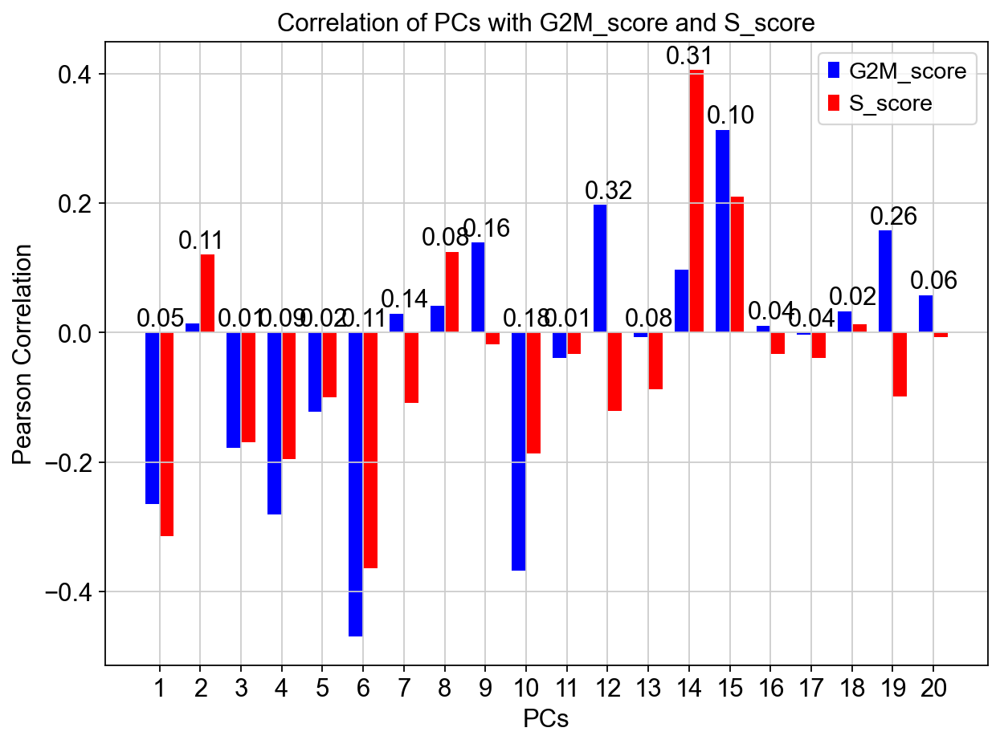

array([11, 13, 18,  9,  8,  6,  5,  1, 14,  3,  7, 12, 19,  0, 15, 16,  4,
       17,  2, 10])

In [143]:
scH.findDiffPCs(adata, label1="G2M_score", label2="S_score", lenPCs=20, show=True)

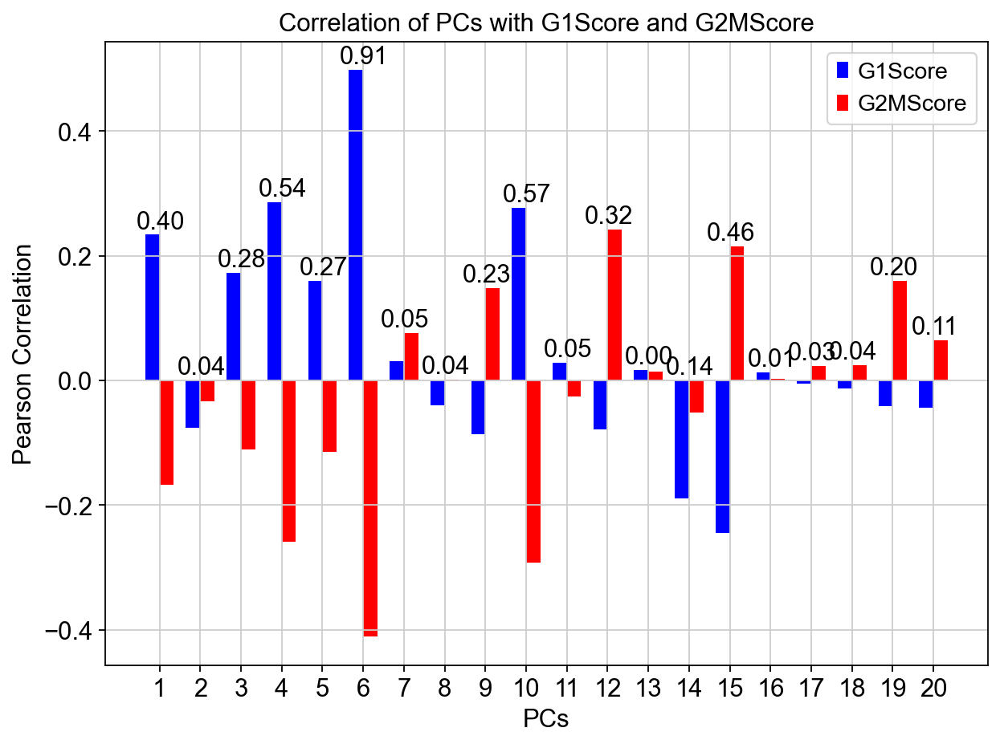

array([ 5,  9,  3, 14,  0, 11,  2,  4,  8, 18, 13, 19, 10,  6,  1,  7, 17,
       16, 15, 12])

In [144]:
scH.findDiffPCs(adata, label1="phase", label2=None, lenPCs=20, show=True)

In [145]:
adata

AnnData object with n_obs × n_vars = 14508 × 1463
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'G1Score', 'G2MScore', 'scBasalScore', 'scClassicalScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'treatment_colors', 'umap', 'cellState_colors', 'decoupler_colors', 'zsig_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [146]:
adata.write(resultsFileTotal)
#adata = sc.read(resultsFileTotal)
adata

AnnData object with n_obs × n_vars = 14508 × 1463
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'G1Score', 'G2MScore', 'scBasalScore', 'scClassicalScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'treatment_colors', 'umap', 'cellState_colors', 'decoupler_colors', 'zsig_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [147]:
#adata = adata[adata.obs.tumor=="tum"]
#adata = adata[adata.obs["tdT+"]=="tdT+"]

#adata = adata.raw.to_adata()

In [148]:
#sc.pp.highly_variable_genes(adata, batch_key="treatment")#, flavor = "seurat", n_top_genes=2000)

In [149]:
#sc.pl.highly_variable_genes(adata)

In [150]:
#for inGene in adata.var[-8:].index.tolist():
#    adata.var.loc[inGene,"highly_variable"] = False

In [151]:
#adata.var['mt'] = adata.var_names.str.startswith('mt-') 

In [152]:
#adata.raw = adata

In [153]:
#adata = adata[:, adata.var.highly_variable]
#adata = adata[:, np.logical_and(adata.var.highly_variable, np.logical_not(adata.var.mt))]
#adata = adata[:, np.logical_and(adata.var.highly_variable_intersection, np.logical_not(adata.var.mt))]
#

In [154]:
#sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

In [155]:
#sc.pp.scale(adata, max_value=10)

In [156]:
#sc.tl.pca(adata, n_comps = 200, svd_solver='arpack')

In [157]:
#sc.pl.pca_variance_ratio(adata, n_pcs = 200, log=True)

In [158]:
#sc.pl.pca_variance_ratio(adata, n_pcs = 200)

In [159]:
#sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

In [160]:
#sc.tl.umap(adata)

In [161]:
#sc.tl.leiden(adata, resolution=0.4)

In [162]:
#sc.pl.umap(adata, color=["leiden","GMM","treatment","phase"],ncols=4)

In [163]:
#sc.pl.pca(adata, color=["leiden","GMM","treatment","phase"],ncols=4, dimensions= [(0, 1)],annotate_var_explained=True)

In [164]:
#sc.pl.pca(adata, color=["leiden","GMM","treatment","phase"],ncols=4, dimensions= [(0, 2)],annotate_var_explained=True)

In [165]:
#sc.pl.umap(adata, color=["n_genes_by_counts","pct_counts_mt","total_counts"])

In [166]:
#sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon', use_raw=False)
#sc.tl.filter_rank_genes_groups(adata, groupby="leiden", use_raw=False,
#                                   key_added='rank_genes_groups_filtered', 
#                                   min_in_group_fraction=0.25, min_fold_change=1, max_out_group_fraction=0.5, compare_abs=False)
#sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [167]:
#pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(15)

In [168]:
#sc.tl.dendrogram(adata,groupby="leiden", n_pcs=50)
#sc.pl.rank_genes_groups_dotplot(adata,n_genes=3)#,key="rank_genes_groups_filtered")

In [169]:
resultsFile

'write/pdacPdxMrtxGA60.h5ad'

In [170]:
adata

AnnData object with n_obs × n_vars = 14508 × 1463
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'G1Score', 'G2MScore', 'scBasalScore', 'scClassicalScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'treatment_colors', 'umap', 'cellState_colors', 'decoupler_colors', 'zsig_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [171]:
adata.write(resultsFile)
adata

AnnData object with n_obs × n_vars = 14508 × 1463
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'G1Score', 'G2MScore', 'scBasalScore', 'scClassicalScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'treatment_colors', 'umap', 'cellState_colors', 'decoupler_colors', 'zsig_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [172]:
adata = sc.read(resultsFile)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [173]:
homology = pd.read_table("data/hgncHM_121.csv", sep=",")
mouseGenes = np.array(homology["mouse"])
humanGenes = np.array(homology["human"])
homology

,mouse,human
0,A1bg,A1BG
1,A1cf,A1CF
2,A2m,A2M
3,A3galt2,A3GALT2
4,A4galt,A4GALT
...,...,...
17271,Zyg11a,ZYG11A
17272,Zyg11b,ZYG11B
17273,Zyx,ZYX
17274,Zzef1,ZZEF1


In [174]:
sigGenes = pd.read_csv("data/basClaSigGenes.csv")
sigGenes = sigGenes[["scBasal","scClassical"]]

In [175]:
#set(sigGenes["basal"]).intersection(set(sigGenes["scBasal"]))

In [176]:
#set(sigGenes["classical"]).intersection(set(sigGenes["scClassical"]))

In [177]:
#set(sigGenes["scBasal"]).intersection(set(sigGenes["EMT"]))

In [178]:
#set(sigGenes["scClassical"]).intersection(set(sigGenes["EMT"]))

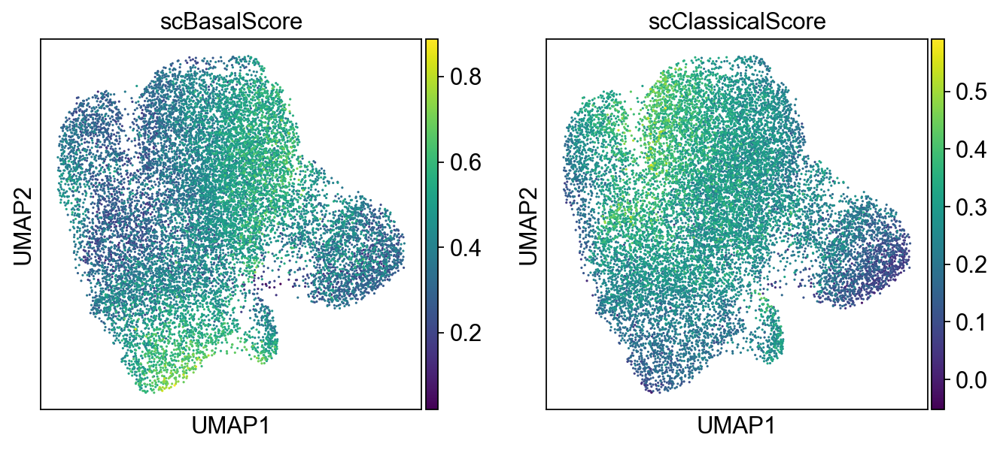

In [179]:
scoreNames, newBClabel, ogLabelScoreMed = scH.scoreAndLabel(adata, sigGenes, 
#                                                            labelOfSigGenes= ["basal","basal","classical","classical","EMT"],
                                                            labelOfSigGenes= ["basal","classical"],
                                                            ogLabel="leiden")#,translate=False, humanGenes=mouseGenes, mouseGenes=humanGenes )

sc.pl.umap(adata, color=scoreNames, ncols=3)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


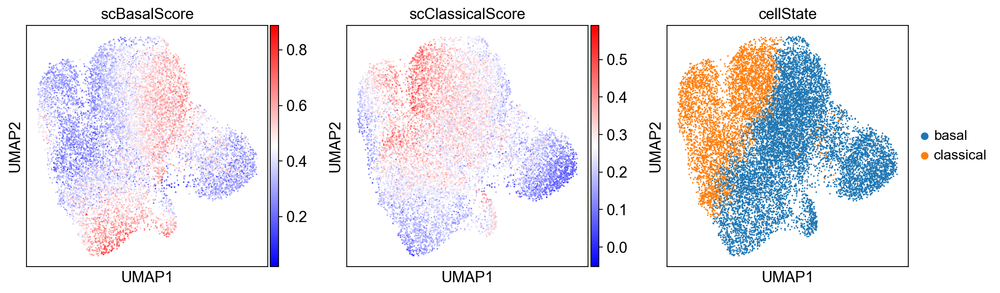

In [180]:
sc.pl.umap(adata, color=scoreNames+["cellState"],ncols=4,cmap="bwr")

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


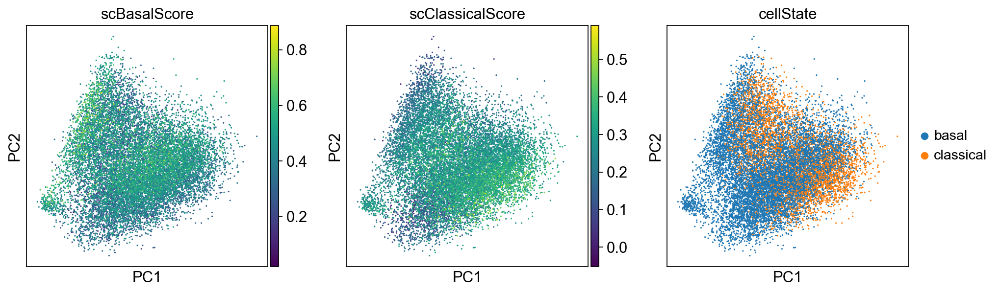

In [181]:
sc.pl.pca(adata, color=scoreNames+["cellState"],ncols=4)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

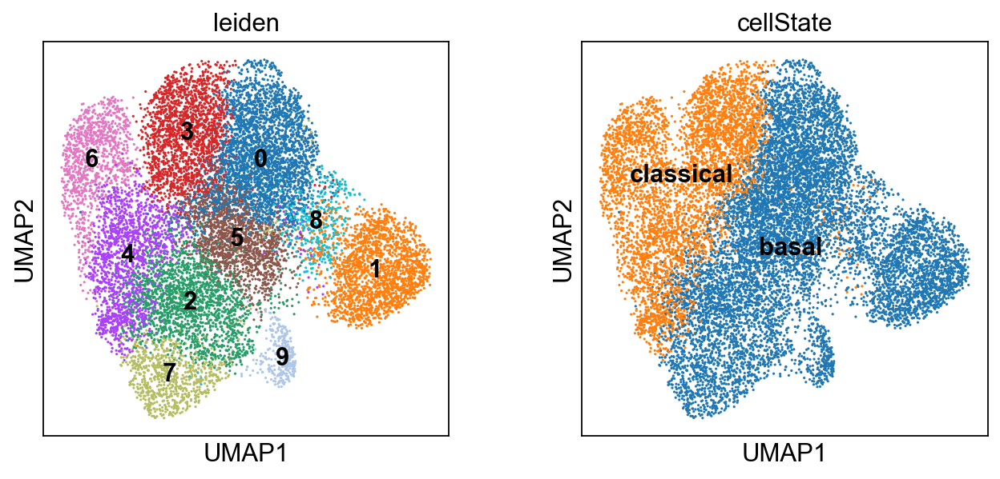

In [182]:
#sc.tl.leiden(adata, resolution=0.2)
sc.pl.umap(adata, color = ["leiden","cellState"], legend_loc="on data")

In [183]:
classLabDict = dict(zip(sigGenes.columns,["basal","classical","EMT"]))#"basal","classical",
markers = pd.DataFrame(np.empty((200*12,2), dtype="object"), columns=["genes", "clustName"])
for i,clust in enumerate(sigGenes.columns):
    for j,gene in enumerate(sigGenes.index):
        gene = sigGenes.loc[gene,clust]
        indexOver = np.where(humanGenes == gene)[0]
        if indexOver.size > 0:
            gene = mouseGenes[indexOver[0]]
        markers.iloc[i*200+j] = gene,classLabDict[clust]
        
markers = markers.dropna()
markers

,genes,clustName
0,KRT6A,basal
1,S100A2,basal
2,Krt13,basal
3,Krt17,basal
4,Ly6d,basal
...,...,...
395,Abcc3,classical
396,Rabac1,classical
397,Ass1,classical
398,Chchd10,classical


In [184]:
markers = markers.drop_duplicates()
markers

,genes,clustName
0,KRT6A,basal
1,S100A2,basal
2,Krt13,basal
3,Krt17,basal
4,Ly6d,basal
...,...,...
395,Abcc3,classical
396,Rabac1,classical
397,Ass1,classical
398,Chchd10,classical


In [185]:
adata

AnnData object with n_obs × n_vars = 14508 × 1463
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'G1Score', 'G2MScore', 'scBasalScore', 'scClassicalScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'cellState_colors', 'decoupler_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'treatment_colors', 'umap', 'zsig_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [186]:
import decoupler as dc

In [187]:
dc.run_ora(
    mat=adata,
    net=markers,
    source='clustName',
    target='genes',
    min_n=3,
    verbose=True
)

1 features of mat are empty, they will be removed.
Running ora on mat with 14508 samples and 23941 targets for 2 sources.


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 14508/14508 [00:14<00:00, 1016.27it/s]


In [188]:
acts = dc.get_acts(adata, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

acts

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 14508 × 2
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'G1Score', 'G2MScore', 'scBasalScore', 'scClassicalScore', 'cellState', 'decoupler', 'zsig'
    uns: 'cellState_colors', 'decoupler_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'treatment_colors', 'umap', 'zsig_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


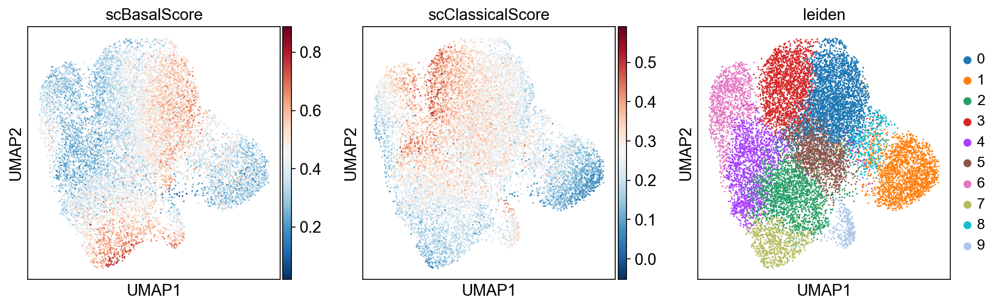

In [189]:
sc.pl.umap(acts, color=scoreNames+['leiden'], cmap='RdBu_r')

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: 

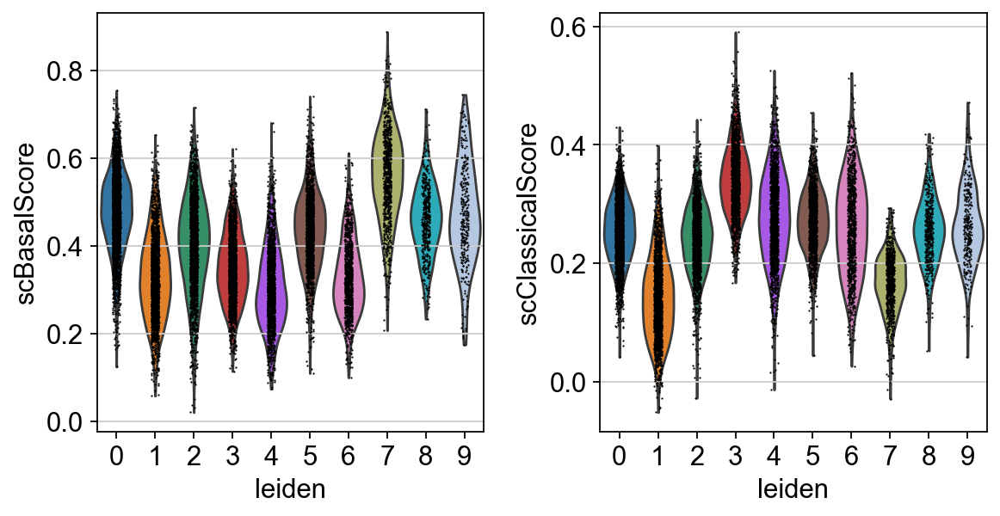

In [190]:
sc.pl.violin(acts, keys=scoreNames, groupby='leiden')

In [191]:
df = dc.rank_sources_groups(acts, groupby='leiden', reference='rest', method='t-test_overestim_var')
df

,group,reference,names,statistic,meanchange,pvals,pvals_adj
0,0,rest,classical,3.936049,0.034690,8.381045e-05,1.676209e-04
1,0,rest,basal,-0.143778,-0.002131,8.856801e-01,8.856801e-01
2,1,rest,basal,7.473975,0.153234,9.629981e-14,9.629981e-14
3,1,rest,classical,-28.467727,-0.286097,2.191097e-158,4.382194e-158
4,2,rest,basal,-1.650575,-0.031130,9.890863e-02,9.890863e-02
5,2,rest,classical,-7.130603,-0.080354,1.201077e-12,2.402154e-12
6,3,rest,classical,25.722228,0.349799,3.274012e-133,6.548024e-133
7,3,rest,basal,-5.996175,-0.116387,2.215398e-09,2.215398e-09
8,4,rest,classical,-5.216050,-0.070911,1.943321e-07,1.943321e-07
9,4,rest,basal,-10.020425,-0.199797,2.742282e-23,5.484565e-23


In [192]:
n_ctypes = 3
ctypes_dict = df.groupby('group').head(n_ctypes).groupby('group')['names'].apply(lambda x: list(x)).to_dict()
ctypes_dict

{'0': ['classical', 'basal'],
 '1': ['basal', 'classical'],
 '2': ['basal', 'classical'],
 '3': ['classical', 'basal'],
 '4': ['classical', 'basal'],
 '5': ['basal', 'classical'],
 '6': ['classical', 'basal'],
 '7': ['basal', 'classical'],
 '8': ['basal', 'classical'],
 '9': ['basal', 'classical']}

In [193]:
#sc.pl.matrixplot(acts, ctypes_dict, 'leiden', dendrogram=True, standard_scale='var',colorbar_title='Z-scaled scores', cmap='RdBu_r')

In [194]:
annotation_dict = df.groupby('group').head(1).set_index('group')['names'].to_dict()
annotation_dict

{'0': 'classical',
 '1': 'basal',
 '2': 'basal',
 '3': 'classical',
 '4': 'classical',
 '5': 'basal',
 '6': 'classical',
 '7': 'basal',
 '8': 'basal',
 '9': 'basal'}

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

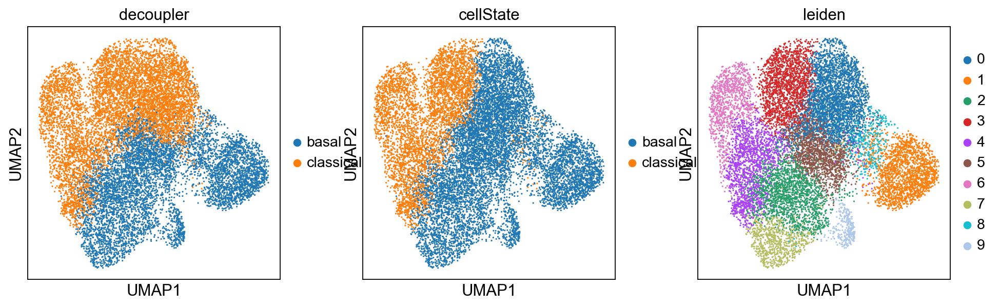

In [195]:
# Add cell type column based on annotation
adata.obs['decoupler'] = [annotation_dict[clust] for clust in adata.obs['leiden']]

# Visualize
sc.pl.umap(adata, color=['decoupler','cellState', "leiden"])

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

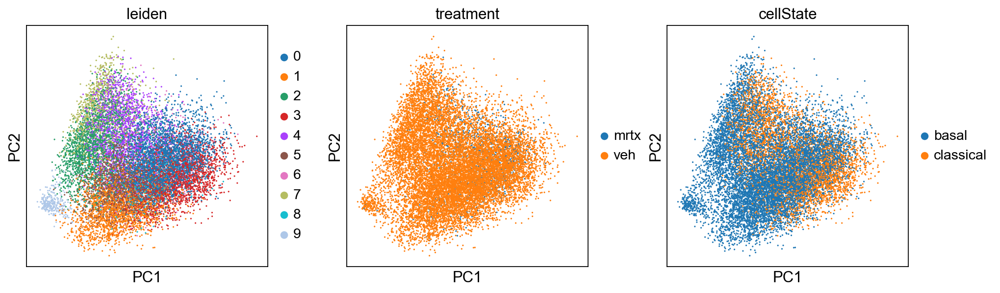

In [196]:
sc.pl.pca(adata, color=["leiden","treatment","cellState"],ncols=4)

In [197]:
scH.addIndvLabel(adata, [f"{sigName}Score" for sigName in sigGenes.columns], obsLabel="zsig", cutoff=0)

AnnData object with n_obs × n_vars = 14508 × 1463
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'G1Score', 'G2MScore', 'scBasalScore', 'scClassicalScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'cellState_colors', 'decoupler_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'treatment_colors', 'umap', 'zsig_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

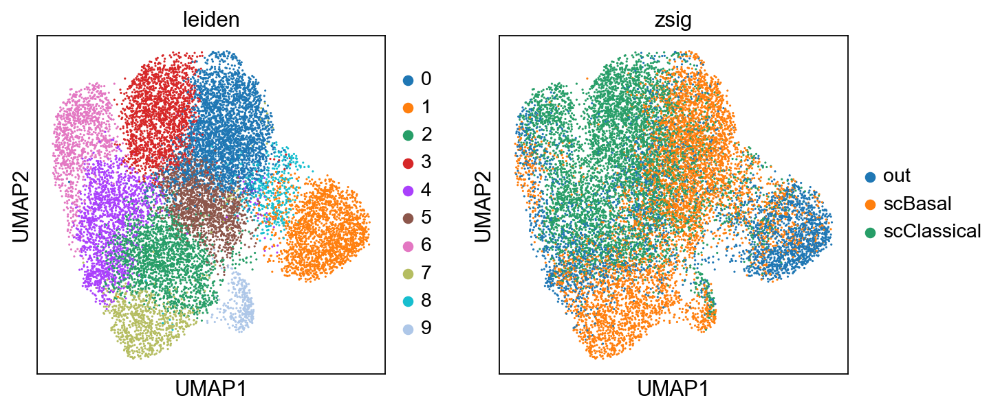

In [198]:
sc.pl.umap(adata, color=["leiden","zsig"])#, legend_loc="on data")

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: 

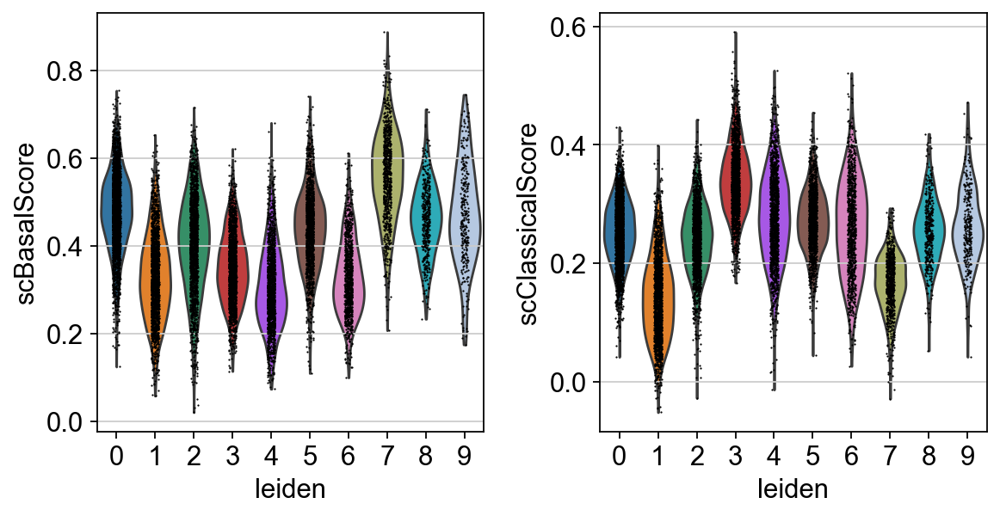

In [199]:
sc.pl.violin(adata, keys=scoreNames, groupby='leiden')

In [200]:
adata.write(resultsFile)
adata

AnnData object with n_obs × n_vars = 14508 × 1463
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'G1Score', 'G2MScore', 'scBasalScore', 'scClassicalScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'cellState_colors', 'decoupler_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase_colors', 'rank_genes_groups', 'treatment_colors', 'umap', 'zsig_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [201]:
resultsFile

'write/pdacPdxMrtxGA60.h5ad'

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


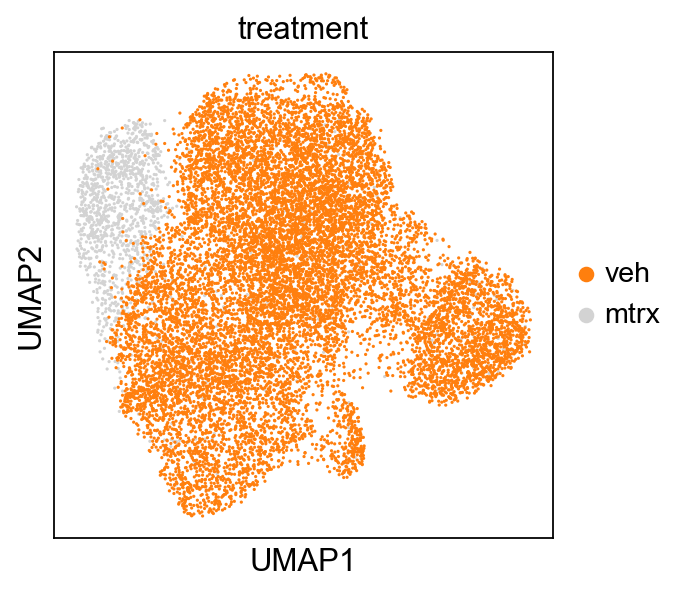

In [202]:
ax=sc.pl.umap(adata,color=['treatment'],groups=['veh'], show=False)

# We can change the 'NA' in the legend that represents all cells outside of the
# specified groups
legend_texts=ax.get_legend().get_texts()
# Find legend object whose text is "NA" and change it
for legend_text in legend_texts:
    if legend_text.get_text()=="NA":
        legend_text.set_text('mtrx')

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

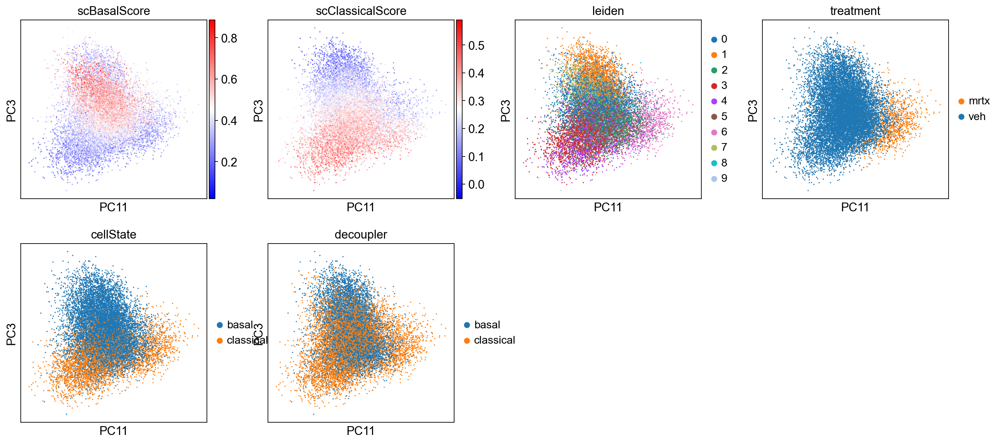

In [216]:
#sc.pl.umap(acts, color=scoreNames+['leiden'], cmap='RdBu_r')
sc.pl.pca(adata, color=scoreNames+["leiden","treatment","cellState","decoupler"],ncols=4, cmap="bwr", dimensions=[10,2])

In [218]:
adata.obs[["treatment","cellState"]].value_counts()

treatment  cellState
veh        basal        9815
           classical    3327
mrtx       classical    1188
           basal         178
Name: count, dtype: int64

In [204]:
adata.uns["treatment_colors"] = np.array(['#ff7f0e','#1f77b4'])

In [ ]:
#sc.pl.umap(acts, color=scoreNames+['leiden'], cmap='RdBu_r')
sc.pl.pca(adata, color=scoreNames+["leiden","treatment","cellState","decoupler"],ncols=4, cmap="bwr", dimensions=[2,3])

In [ ]:
sc.pl.umap(adata, color=scoreNames+["leiden","treatment","cellState","decoupler"],ncols=4)

In [ ]:
sc.pl.pca(adata, color=scoreNames+["leiden","treatment","cellState","phase"],ncols=4)

In [ ]:
sc.pl.pca(adata, color=scoreNames+["leiden","treatment","cellState","phase"],ncols=4,dimensions=[(2,3)])

In [ ]:
sc.pl.violin(adata, keys=scoreNames, groupby="treatment")

In [217]:
adata.write(resultsFile)

In [ ]:
adata = sc.read(resultsFile)

In [ ]:
sc.pl.umap(adata, color=scoreNames+["cellState","treatment"],ncols=3,cmap="bwr")

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
from scipy import stats

alpha=0.01
trtClass = adata[adata.obs.treatment=="mrtx"].obs["scClassicalScore"]
vehClass = adata[adata.obs.treatment=="veh"].obs["scClassicalScore"]

u_statistic, p_value = stats.mannwhitneyu(trtClass,vehClass, alternative="greater")
if p_value < alpha:
    print("Reject the null hypothesis: The means are significantly different.")
else:
    print("Fail to reject the null hypothesis: No significant difference detected.")

print(f"mannwhitneyu’s u-statistic: {u_statistic:.4f}, p-value: {p_value:.4f}")

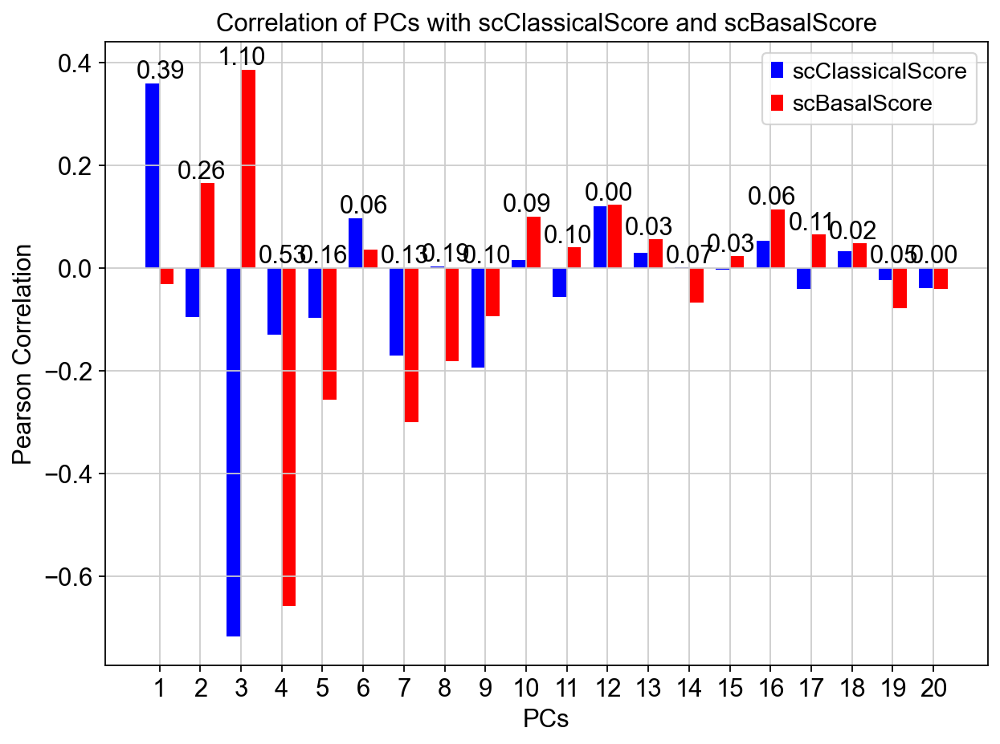

array([ 2,  3,  0,  1,  7,  4,  6, 16,  8, 10,  9, 13, 15,  5, 18, 12, 14,
       17, 11, 19])

In [208]:
scH.findDiffPCs(adata, label1="scClassicalScore", label2="scBasalScore", lenPCs=20, show=True)

In [ ]:
adata

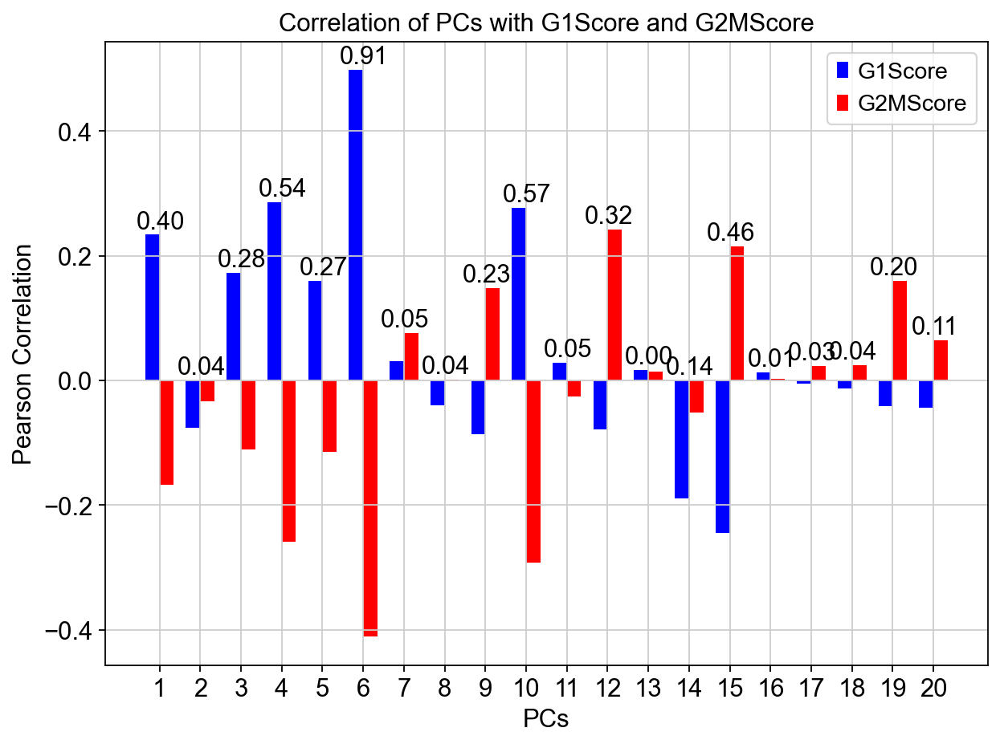

array([ 5,  9,  3, 14,  0, 11,  2,  4,  8, 18, 13, 19, 10,  6,  1,  7, 17,
       16, 15, 12])

In [209]:
scH.findDiffPCs(adata, label1="phase", label2=None, lenPCs=20, show=True)

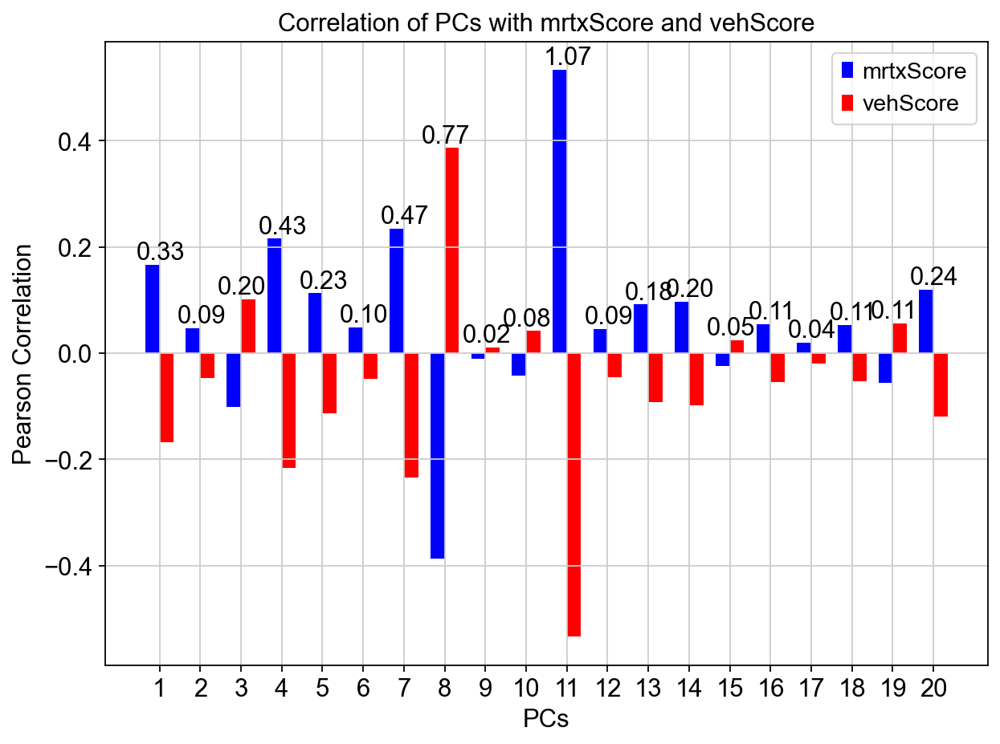

array([10,  7,  6,  3,  0, 19,  4,  2, 13, 12, 18, 15, 17,  5,  1, 11,  9,
       14, 16,  8])

In [210]:
scH.findDiffPCs(adata, label1="treatment", label2=None, lenPCs=20, show=True)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: 

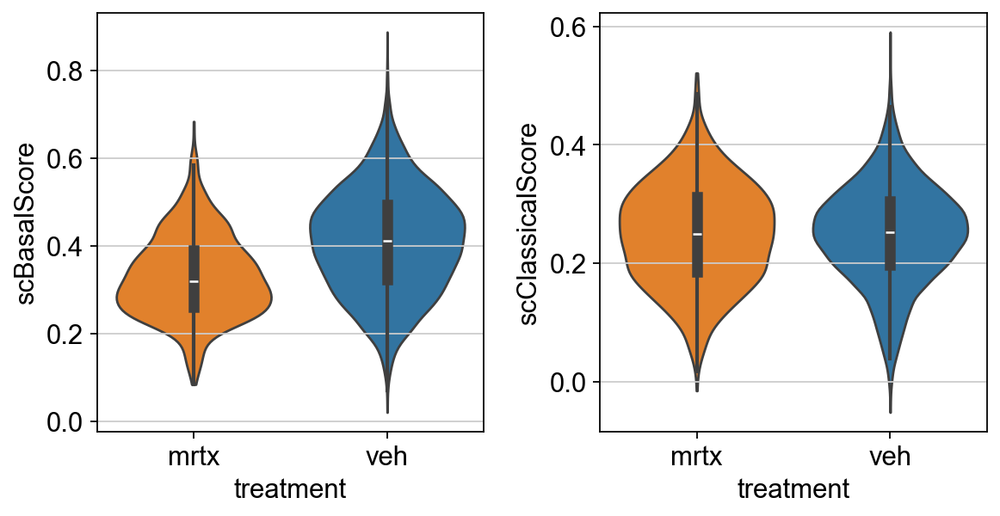

In [206]:
sc.pl.violin(adata,  keys=["scBasalScore", "scClassicalScore"], groupby="treatment",  inner = "box", stripplot=False)

In [7]:
adata = sc.read(resultsFile)
adata

AnnData object with n_obs × n_vars = 5097 × 2098
    obs: 'MRTX1_B0251', 'MRTX2_B0252', 'MRTX3_B0253', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mm', 'pct_counts_mm', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'Vehicle1_B0254', 'Vehicle2_B0255', 'Vehicle3_B0256', 'treatment', 'S_score', 'G2M_score', 'phase', 'leiden', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'GMM_colors', 'cellState_colors', 'decoupler_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'phase

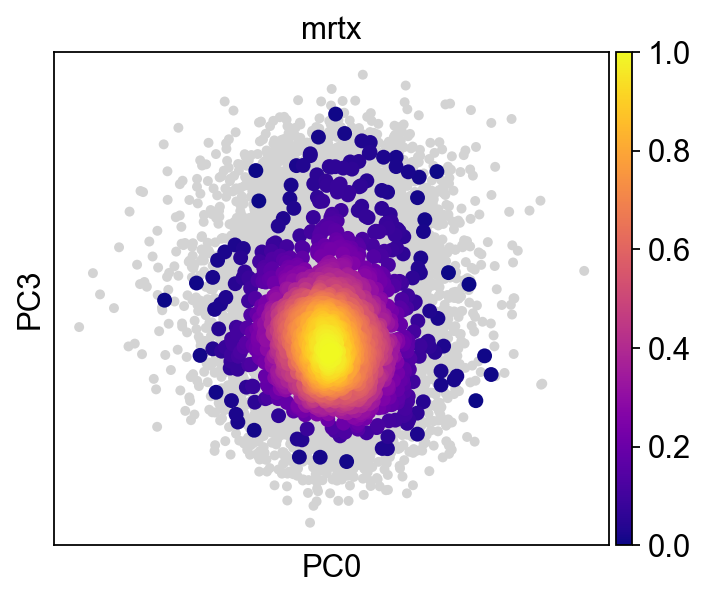

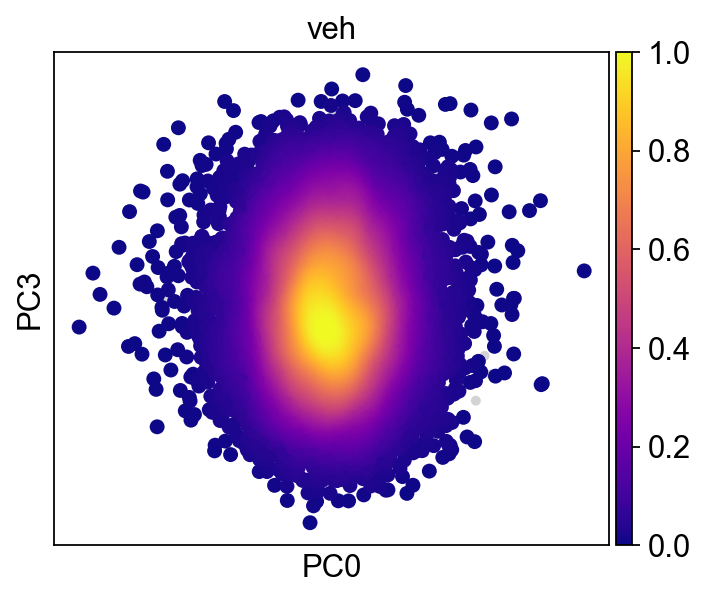

In [211]:
sc.tl.embedding_density(adata, basis='pca', groupby="treatment", components=[0,3])
sc.pl.embedding_density(adata, basis='pca', key='pca_density_treatment', group="mrtx", color_map="plasma")
sc.pl.embedding_density(adata, basis='pca', key='pca_density_treatment', group="veh", color_map="plasma")

In [ ]:
sc.pl.pca(adata, color=["scClassicalScore"],dimensions=[(2,3)])

In [ ]:
sc.pl.pca(adata, color=["scBasalScore"],dimensions=[(2,3)])

In [68]:
markers = ['Dusp6',  'Etv1', 'Etv5', 'Ccnd1', 'Spry2']
mouselist = list(homology["mouse"].values)
humanMarkers = [homology.iloc[mouselist.index(g),1] for g in markers]

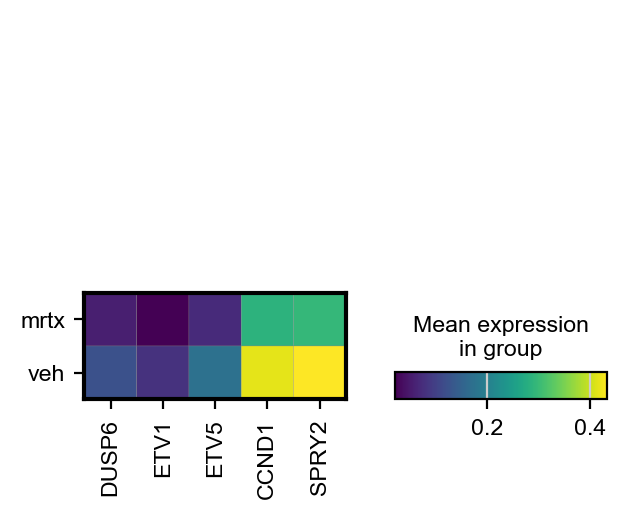

In [71]:
sc.pl.MatrixPlot(adata, humanMarkers, groupby="treatment").show()

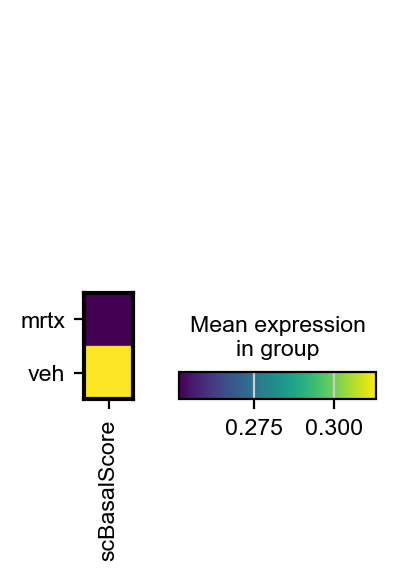

In [133]:
sc.pl.MatrixPlot(adata, ["scBasalScore"], groupby="treatment").show()

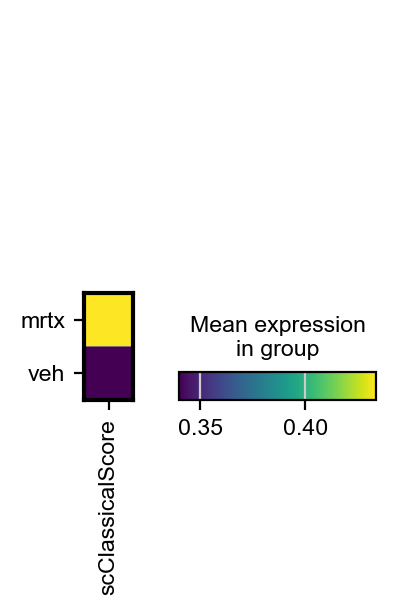

In [134]:
sc.pl.MatrixPlot(adata, ["scClassicalScore"], groupby="treatment").show()

In [99]:
huMarkGex = np.asarray(adata.raw.to_adata()[:,humanMarkers].X.todense()).T

In [125]:
huMarkGex = huMarkGex[:,np.argsort(adata.obsm["X_pca"][:,2])]

<Axes: >

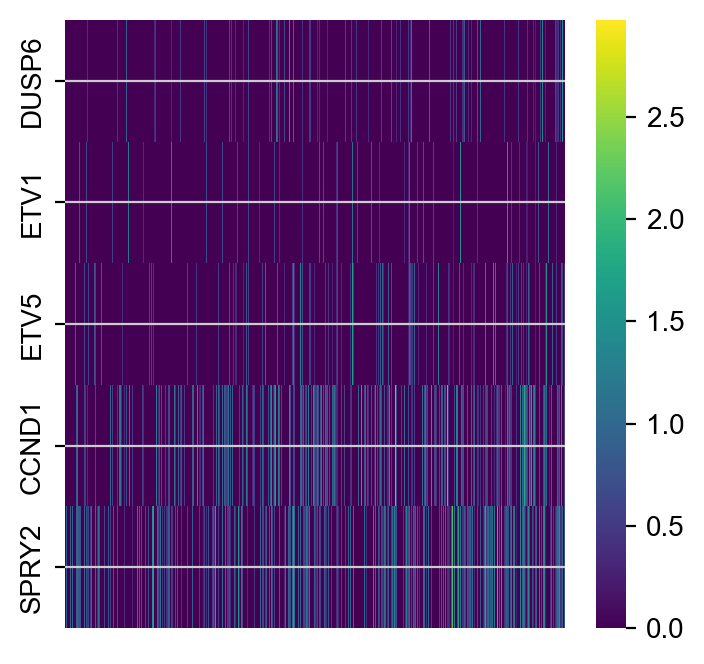

In [126]:
sns.heatmap(huMarkGex, yticklabels=humanMarkers ,cmap="viridis",xticklabels=[])        

<Axes: >

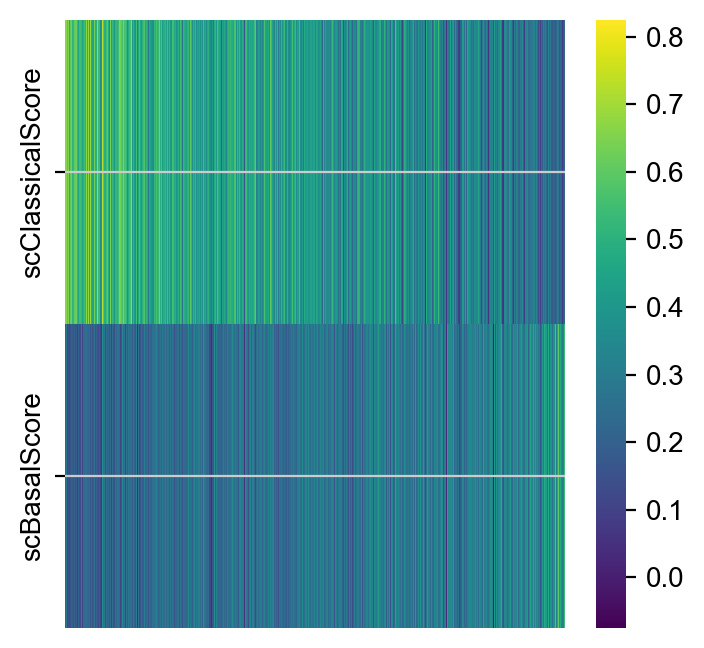

In [132]:
basClas = np.asarray(adata.obs[["scClassicalScore","scBasalScore"]].values).T
basClas = basClas[:,np.argsort(adata.obsm["X_pca"][:,2])]
sns.heatmap(basClas, yticklabels=["scClassicalScore","scBasalScore"] ,cmap="viridis",xticklabels=[])        